 # Heatmap SINDy Representation



 An experiment using SINDy to represent a heatmap dataset.

 ### Install Requirements

In [1]:
# Upgrade pip
!python3 -m pip install -q -U pip

# Install from requirements.txt
%pip install -q -r requirements.txt

# # Or:
# # ---------------------------
# # Manual Install Requirements (assuming `pip install notebook` or `pip install jupyterlab` has already run)
# 
# # For datasets
# %pip install -q numpy pandas
#  
# # For LASSO and ODE and PDE support
# %pip install -q scikit-learn scipy
#  
# # For plotting
# %pip install -q matplotlib seaborn
#  
# # For SINDy implementation
# %pip install -q pysindy

%matplotlib inline


Note: you may need to restart the kernel to use updated packages.


In [2]:
import numpy as np
import matplotlib.pyplot as plt
import scipy.integrate as ode

# # Uncomment when running as non jupyter notebook
# import matplotlib
# matplotlib.use('TkAgg')

import pysindy as ps
import pysindy.utils as psutils
import pysindy.optimizers as psopts

import joblib
# # Uncomment when running as non jupyter notebook
# import pprint
# display = pprint.pprint

# Set seed for reproducible results
np.random.seed(100)

# Add print formatting for np
np.set_printoptions(linewidth=np.inf, precision=3, suppress=True)

# Remove warnings
import warnings
warnings.filterwarnings('ignore')


In [3]:
def generate_heatmap_states(matrix_dim, max_time, diffusion_coefficent=0.2):
    def generate_heat_value(row, col):
        # Find matrix center
        matrix_center = matrix_dim / 2.0

        # Find offsets from center
        # (no need for abs() since will be squared later)
        row_offset = row - matrix_center
        col_offset = col - matrix_center

        # Use product of squared offsets as heat value
        return (row_offset ** 2) * (col_offset ** 2)
    
    # Store all states (used as X)
    all_states = np.zeros((max_time, matrix_dim * matrix_dim), dtype=np.float32)
    
    # Allocate buffers for the current state and the next state
    current_state = np.zeros((matrix_dim, matrix_dim), dtype=np.float32)
    next_state = np.zeros((matrix_dim, matrix_dim), dtype=np.float32)

    # Initialize the starting state for the heatmap
    for row in range(matrix_dim):
        for col in range(matrix_dim):
            current_state[row, col] = generate_heat_value(row, col)

    all_states[0, :] = current_state.flatten()

    # Generate the data at all times from t_0 to t_{T - 1}
    for current_time in range(1, max_time):
        # Dirichlet boundaries
        next_state[0, :] = 0
        next_state[-1, :] = 0
        next_state[:, 0] = 0
        next_state[:, -1] = 0

        # for row in range(1, matrix_dim - 1):
        #     for col in range(1, matrix_dim - 1):
        #         # Apply stencil
        #         stencil_value = previous_state[row, col] + \
        #                             previous_state[row - 1, col] + \
        #                             previous_state[row + 1, col] + \
        #                             previous_state[row, col - 1] + \
        #                             previous_state[row, col + 1]
                
        #         # Scale by diffusion coefficient
        #         current_state[row, col] = diffusion_coefficent * stencil_value

        # Vectorized version of the above
        #
        #       0,1
        #  1,0  1,1  1, 2
        #       2,1
        #
        # to
        #
        #                  len-2, len-1
        #   len-1, len-2   len-1, len-1    len-1, len
        #                  len, len-1
        #
        #
        #                 0:-2, 1:-1
        #   1:-1, :-2     1:-1, 1:-1     1:-1, 2:
        #                 2:, 1;-1
        #
        next_state[1:-1, 1:-1] = diffusion_coefficent * (
            current_state[1:-1, 1:-1]          # Center
            + current_state[:-2, 1:-1]         # Top
            + current_state[2:, 1:-1]          # Bottom
            + current_state[1:-1, :-2]         # Left
            + current_state[1:-1, 2:]          # Right
        )

        # Add the state matrix to our X (flatten 2D matrix into a row of features)
        all_states[current_time, :] = next_state.flatten()

        # Use the next state as the new current state
        next_state, current_state = current_state, next_state

    return all_states


 ### Generate Input (Starting State) and Training Data (Full State) for fitting



 #### Generating Starting State



 We create a constant starting state, based on Dr. Underwood's `heatdist.cc`  implementation.



 $$

 x(t = 0) = \begin{bmatrix}

 \vdots & \vdots & \vdots & \vdots \\

 1 & 1 & \dots & 1 \\

 0 & 0 & \dots & 0 \\

 1 & 1 & \dots & 1 \\

 \vdots & \vdots & \vdots & \vdots

 \end{bmatrix}

 $$



 #### Generating Full State



 We condense a state into a flattened vector (1D array), where each row represents a time, and each column are the $N \times N$ heatmap values, whose governing equations must be learned by SINDy.



 We define that the states are equidistant in time $\Delta t = 1$ and have times $t \in [0, 50]$ ($t \in [51, 80]$ is part of the test dataset for later).


We can then use a 5-point stencil per $\Delta t$ to alter each temperature value as the sum of all neighbors (up, down, left, right) times a diffusion coefficient ($0.2$ in our case).


 We can define the full states at all times $t$ (this is represented by an entire row in the matrix) to look as the following:



 $$

 X = \begin{bmatrix}

     \dots & 1 & 1 & \dots & 1 & \dots \\

      & \vdots & \vdots &  & \vdots

 \end{bmatrix}

 $$

In [4]:
matrix_dim = 50
X_train_max_time = 50
X_test_max_time = 80
DIFFUSION_COEFFICIENT = 0.2
DELTA_TIME = 1

X_test = generate_heatmap_states(matrix_dim, X_test_max_time, diffusion_coefficent=DIFFUSION_COEFFICIENT)
X_train = X_test[:X_train_max_time]
X_train_starting_state = X_train[0].reshape((matrix_dim, matrix_dim))
X_train_ending_state = X_train[-1].reshape((matrix_dim, matrix_dim))

print(f'Starting State {X_train_starting_state.shape}:')
display(X_train_starting_state)
print()

print(f'Ending State {X_train_ending_state.shape}:')
display(X_train_ending_state)
print()


print(f'All States {X_train.shape}')
display(X_train)
print()


Starting State (50, 50):


array([[390625., 360000., 330625., ..., 302500., 330625., 360000.],
       [360000., 331776., 304704., ..., 278784., 304704., 331776.],
       [330625., 304704., 279841., ..., 256036., 279841., 304704.],
       ...,
       [302500., 278784., 256036., ..., 234256., 256036., 278784.],
       [330625., 304704., 279841., ..., 256036., 279841., 304704.],
       [360000., 331776., 304704., ..., 278784., 304704., 331776.]], shape=(50, 50), dtype=float32)


Ending State (50, 50):


array([[    0.   ,     0.   ,     0.   , ...,     0.   ,     0.   ,     0.   ],
       [    0.   ,  4752.593,  9150.281, ...,  8246.641,  4285.902,     0.   ],
       [    0.   ,  9150.281, 17616.926, ..., 15877.273,  8251.811,     0.   ],
       ...,
       [    0.   ,  8246.64 , 15877.271, ..., 14309.366,  7436.875,     0.   ],
       [    0.   ,  4285.901,  8251.81 , ...,  7436.876,  3865.025,     0.   ],
       [    0.   ,     0.   ,     0.   , ...,     0.   ,     0.   ,     0.   ]], shape=(50, 50), dtype=float32)


All States (50, 2500)


array([[390625., 360000., 330625., ..., 278784., 304704., 331776.],
       [     0.,      0.,      0., ...,      0.,      0.,      0.],
       [     0.,      0.,      0., ...,      0.,      0.,      0.],
       ...,
       [     0.,      0.,      0., ...,      0.,      0.,      0.],
       [     0.,      0.,      0., ...,      0.,      0.,      0.],
       [     0.,      0.,      0., ...,      0.,      0.,      0.]], shape=(50, 2500), dtype=float32)

In [5]:
def plot_heatmap(state, name='Heatmap'):
    plt.imshow(state, origin='lower', cmap='hot')
    plt.colorbar()
    plt.title(name)
    plt.show()


def plot_heatmap_pair(state1, state2, name1='Heatmap 1', name2='Heatmap 2'):
    fig = plt.figure(figsize=(14, 8))

    ax = fig.add_subplot(1, 2, 1)
    ax.imshow(state1, origin='lower', cmap='hot')
    ax.set_title(name1)

    for im in ax.images:
        fig.colorbar(im, ax=ax)

    ax = fig.add_subplot(1, 2, 2)
    ax.imshow(state2, origin='lower', cmap='hot')
    ax.set_title(name2)

    for im in ax.images:
        fig.colorbar(im, ax=ax)
    fig.show()


def plot_heatmaps(all_states, all_names=None, cmap='hot', min_col_count=10):
    state_count = len(all_states)
    if all_names and len(all_names) != state_count:
        raise Exception('invalid names provided')

    col_count = min(min_col_count, state_count)
    row_count = (state_count + col_count - 1) // col_count

    fig = plt.figure(figsize=(4 * col_count, 3 * row_count))
    for idx, state in enumerate(all_states):
        dim = int(np.sqrt(len(state)))
        state = state.reshape((dim, dim))
        ax = fig.add_subplot(row_count, col_count, idx + 1)
        im = ax.imshow(state, origin='lower', cmap=cmap)
        if (all_names):
            ax.set_title(all_names[idx])
        else:
            ax.set_title(f'State {idx}')
        # fig.colorbar(im, ax=ax)

    plt.tight_layout()
    plt.show()



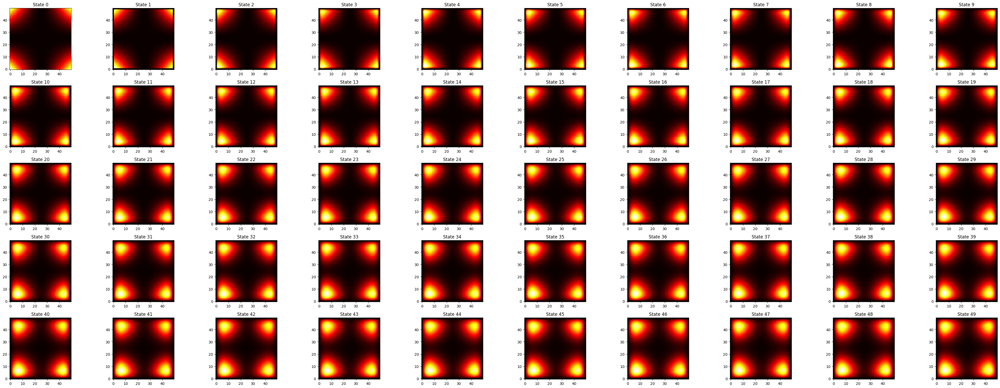

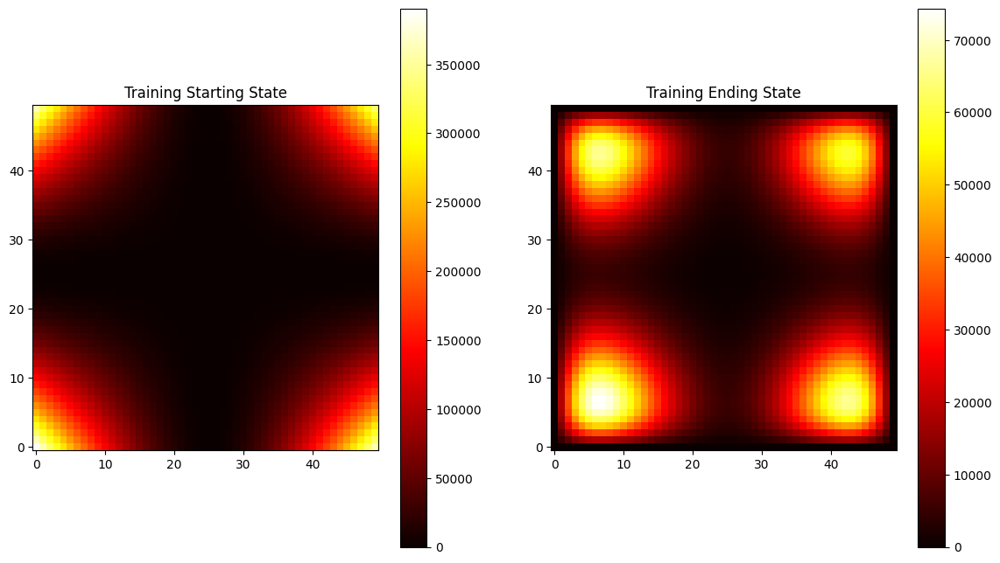

In [6]:
plot_heatmaps(X_train, min_col_count=10)
plot_heatmap_pair(X_train_starting_state, X_train_ending_state, 'Training Starting State', 'Training Ending State')


### Training on SINDy

We can use a discrete version of PySINDy to speed up the derivative calculation, since it it no longer trying to calculate the derivative as if it were a continuous function.

To ensure that PySINDy can find the diffusion coefficient ($0.2$ in this case), we use a Polynomial function library with degree 1 and a STLSQ optimizer.

#### Polynomial Function Library

We use degree = 1 since we want to avoid having an excessive amount of features ($c \cdot x^2$ will never show up since we are using 5-point stencil sums times a diffusion coefficient, but $c \cdot x$ may show up).

#### Sequentially Thresholded Least Squares (STLSQ)

##### Sequentially Thresholded

Threshold is $\lambda$.

$$
\Xi = \{\xi_1, \xi_2, \dots\}
$$

$$
\xi_k ' = \begin{cases}
\xi_k & \text{if} \ \lvert \xi_k \rvert \geq \lambda \\
0 & \text{if} \ \lvert \xi_k \rvert < \lambda \\
\end{cases}
$$

(where $\xi_k '$ is the coefficient at the end of the current iteration after pruning $\xi_k$)

We want a small threshold to avoid pruning away coefficients by accident.

##### L2 (Ridge) Regularization

Large Coefficient penalty is $\alpha$.

$$
\text{Error} _ {k} = \lVert \dot{x}_k - \Theta(X) \xi_k \rVert _ 2 ^ 2 + \alpha \lVert \xi _ k \rVert _ 2 ^ 2
$$

We want a small alpha to avoid penalizing large coefficients.

In [7]:
model = ps.SINDy(
    feature_library=ps.PolynomialLibrary(degree=1),
    optimizer=psopts.STLSQ(
        # At each step, coeff[coeff < threshold] = 0
        threshold=1e-8,
        # At each step, L2 regularize, with penalty for large coeff
        alpha=1e-8,
        max_iter=1000,
    ),
    # t' = t + delta t
    discrete_time=True,
)
model.fit(X_train, t=DELTA_TIME)


,optimizer,STLSQ(alpha=1...reshold=1e-08)
,feature_library,PolynomialLibrary(degree=1)
,differentiation_method,FiniteDifference(axis=-2)
,discrete_time,True
,degree,1
,include_interaction,True
,interaction_only,False
,include_bias,True
,order,'C'
,threshold,1e-08
,alpha,1e-08


In [8]:
model.print()


(x0)[k+1] = 0.000
(x1)[k+1] = 0.000
(x2)[k+1] = 0.000
(x3)[k+1] = 0.000
(x4)[k+1] = 0.000
(x5)[k+1] = 0.000
(x6)[k+1] = 0.000
(x7)[k+1] = 0.000
(x8)[k+1] = 0.000
(x9)[k+1] = 0.000
(x10)[k+1] = 0.000
(x11)[k+1] = 0.000
(x12)[k+1] = 0.000
(x13)[k+1] = 0.000
(x14)[k+1] = 0.000
(x15)[k+1] = 0.000
(x16)[k+1] = 0.000
(x17)[k+1] = 0.000
(x18)[k+1] = 0.000
(x19)[k+1] = 0.000
(x20)[k+1] = 0.000
(x21)[k+1] = 0.000
(x22)[k+1] = 0.000
(x23)[k+1] = 0.000
(x24)[k+1] = 0.000
(x25)[k+1] = 0.000
(x26)[k+1] = 0.000
(x27)[k+1] = 0.000
(x28)[k+1] = 0.000
(x29)[k+1] = 0.000
(x30)[k+1] = 0.000
(x31)[k+1] = 0.000
(x32)[k+1] = 0.000
(x33)[k+1] = 0.000
(x34)[k+1] = 0.000
(x35)[k+1] = 0.000
(x36)[k+1] = 0.000
(x37)[k+1] = 0.000
(x38)[k+1] = 0.000
(x39)[k+1] = 0.000
(x40)[k+1] = 0.000
(x41)[k+1] = 0.000
(x42)[k+1] = 0.000
(x43)[k+1] = 0.000
(x44)[k+1] = 0.000
(x45)[k+1] = 0.000
(x46)[k+1] = 0.000
(x47)[k+1] = 0.000
(x48)[k+1] = 0.000
(x49)[k+1] = 0.000
(x50)[k+1] = 0.000
(x51)[k+1] = 0.011 x0[k] + 0.010 x1[k] + 

### Analysis

We can now analyze the feature library and sparse coefficient matrix.

#### Sparse Coefficient Matrix

We look at the coefficient matrix $\Xi$ to understand the coefficients of the learned differential equations.

The function that we multiply the coefficients by can be found in the Feature Library. Once found, the differential equation is:

$$
\hat{x}_i = \sum _ {j = 0} ^ {p} {\xi _ i \cdot f_j(\dots)}
$$

These matrices are very sparse, so we have a separate function that extracts a few of the nonzero coefficients and their respective feature they represent.

#### Plotting

We plot the heatmaps so that we can compare the training data's final state with the simulated final state. These look very similar.

Even if we use testing data that PySINDy didn't see before, we can still see very similar plots for the simulated final state.

In [9]:
def print_feature_library(model):
    feature_library = model.feature_library
    all_candidates = feature_library.get_feature_names()

    print('Feature Library (aligned with coefficient `col`):')

    # Column
    print('Col:', end='      ')
    for col in range(len(all_candidates)):
        print(f'{col:<5}', end='      ')
    print()

    # Terms associated with numbering
    print('Term:', end='     ')
    for term in all_candidates:
        print(f'{term:<5}', end='      ')
    print()

In [10]:
print_feature_library(model)

Feature Library (aligned with coefficient `col`):
Col:      0          1          2          3          4          5          6          7          8          9          10         11         12         13         14         15         16         17         18         19         20         21         22         23         24         25         26         27         28         29         30         31         32         33         34         35         36         37         38         39         40         41         42         43         44         45         46         47         48         49         50         51         52         53         54         55         56         57         58         59         60         61         62         63         64         65         66         67         68         69         70         71         72         73         74         75         76         77         78         79         80         81         82         83         84         85   

In [11]:
# Compact summary of sparse coefficient matrix
xi = model.coefficients()
features = model.feature_library.get_feature_names()
rows, cols = np.nonzero(xi)
total_nonzeros = len(rows)
unique_rows = np.unique(rows)

max_rows_display = 20
max_terms_per_row = 6

rows_to_show = unique_rows[:max_rows_display // 2]
if len(unique_rows) > max_rows_display // 2:
    rows_to_show = np.concatenate([rows_to_show, unique_rows[-max_rows_display // 2:]])

for display_count, index in enumerate(rows_to_show):
    if display_count == max_rows_display // 2 and len(unique_rows) > max_rows_display // 2:
        print("...")
    term_inds = np.sort(cols[rows == index])
    term_coefs = xi[index, term_inds]

    parts = [
        f"{val:.6f} {features[term_ind]}[k]"
        for term_ind, val in zip(term_inds[:max_terms_per_row], term_coefs[:max_terms_per_row])
    ]

    remaining = len(term_inds) - max_terms_per_row
    line = " + ".join(parts)
    if remaining > 0:
        line += f" + ... + ({remaining} more terms)"

    print(f"(x_{index})[k+1] = {line}")

(x_51)[k+1] = 0.010971 x0[k] + 0.010098 x1[k] + 0.009272 x2[k] + 0.008482 x3[k] + 0.007731 x4[k] + 0.007012 x5[k] + ... + (2490 more terms)
(x_52)[k+1] = 0.005018 x0[k] + 0.004639 x1[k] + 0.004262 x2[k] + 0.003901 x3[k] + 0.003551 x4[k] + 0.003222 x5[k] + ... + (2490 more terms)
(x_53)[k+1] = 0.004616 x0[k] + 0.004246 x1[k] + 0.003898 x2[k] + 0.003565 x3[k] + 0.003251 x4[k] + 0.002948 x5[k] + ... + (2490 more terms)
(x_54)[k+1] = 0.004196 x0[k] + 0.003867 x1[k] + 0.003551 x2[k] + 0.003249 x3[k] + 0.002960 x4[k] + 0.002685 x5[k] + ... + (2490 more terms)
(x_55)[k+1] = 0.003805 x0[k] + 0.003508 x1[k] + 0.003220 x2[k] + 0.002947 x3[k] + 0.002684 x4[k] + 0.002435 x5[k] + ... + (2490 more terms)
(x_56)[k+1] = 0.003432 x0[k] + 0.003164 x1[k] + 0.002906 x2[k] + 0.002659 x3[k] + 0.002422 x4[k] + 0.002197 x5[k] + ... + (2490 more terms)
(x_57)[k+1] = 0.003080 x0[k] + 0.002838 x1[k] + 0.002607 x2[k] + 0.002385 x3[k] + 0.002173 x4[k] + 0.001971 x5[k] + ... + (2490 more terms)
(x_58)[k+1] = 0.0027

 Strange Note:

 Using continuous mode takes over 25 minutes to run.

 Using discrete mode only takes 3.6 seconds.

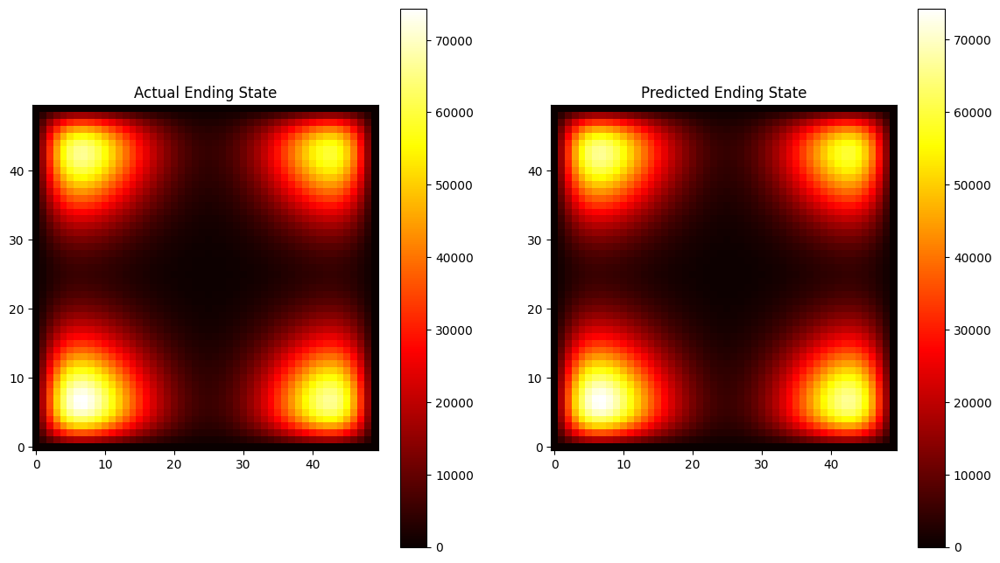

In [12]:
# # Continuous Mode
# X_train_predicted = model.simulate(X_train_starting_state.ravel(), np.arange(0, X_train_max_time, step=DELTA_TIME))

# Discrete Mode
X_train_predicted = model.simulate(X_train_starting_state.ravel(), X_train_max_time)
X_train_predicted_ending_state = X_train_predicted[-1].reshape((matrix_dim, matrix_dim))

plot_heatmap_pair(X_train_ending_state, X_train_predicted_ending_state, 'Actual Ending State', 'Predicted Ending State')



### Save the Model in a File

This file represents the trained SINDy model. Since PySINDy uses scikit-learn, we can use joblib as a (simple) way to dump the model into a file.

The file stores the following attributes:

```python
"""
...

_Base_SINDy: ``BaseEstimator``

    Contains:
    - feature_library: BaseFeatureLibrary
    - optimizer: _BaseOptimizer
    - model: Pipeline
    - feature_names: Optional[list[str]]
    - discrete_time: bool = False
    - n_control_features_: int = 0

model : ``sklearn.multioutput.MultiOutputRegressor``
    The fitted SINDy model.

n_input_features_ : int
    The total number of input features.

n_output_features_ : int
    The total number of output features. This number is a function of
    ``self.n_input_features`` and the feature library being used.

n_control_features_ : int
    The total number of control input features.

...
"""
```

**Note**: The data is about 374 MiB of data for this small example.

In [13]:
MODEL_FILENAME = "pysindy_heatmap.joblib"

joblib.dump(model, MODEL_FILENAME)

print(f"Created file '{MODEL_FILENAME}'")
print()

print('File Size:')
!du -sh "pysindy_heatmap.joblib"


Created file 'pysindy_heatmap.joblib'

File Size:
374M	pysindy_heatmap.joblib


In [14]:
loaded_model = joblib.load(MODEL_FILENAME)
actual_state = X_test[-1].reshape((matrix_dim, matrix_dim))
X_test_predicted = model.simulate(X_test[0], X_test_max_time)
predicted_state = X_test_predicted[-1].reshape((matrix_dim, matrix_dim))

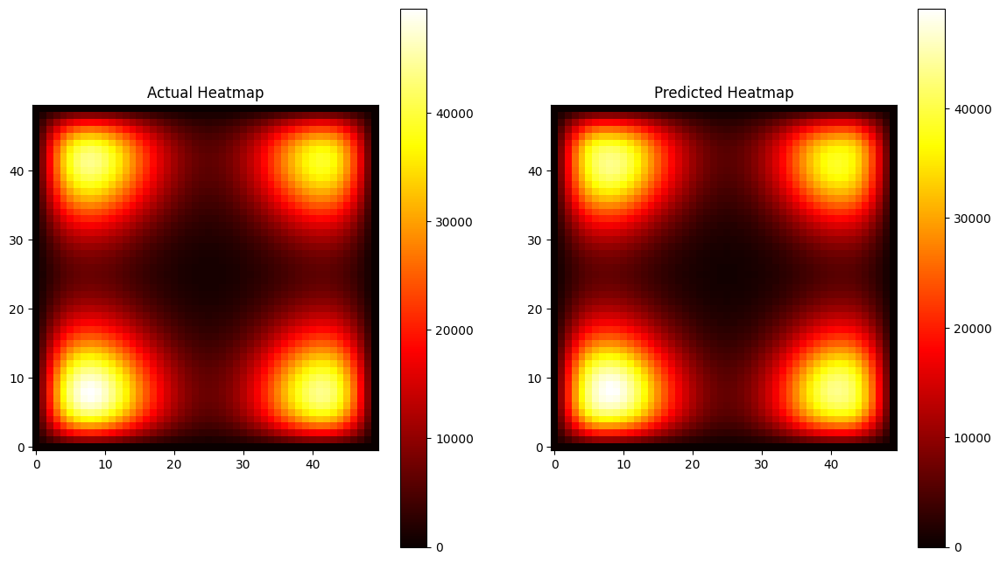

In [15]:
plot_heatmap_pair(actual_state, predicted_state, 'Actual Heatmap', 'Predicted Heatmap')

## Summary / Reference Guide

### Input:

Starting State:

$$
x(t = 0) = \begin{bmatrix}x_0(t = 0) & x_1(t = 0) & x_2(t = 0) & \dots & x_n(t = 0) \end{bmatrix}
$$

Sequence of equidistant times:

$$
T = \{t _ i \colon \lvert t_{i + 1} - t_{i} \rvert = \Delta t, \ \forall i \geq 0 \} \quad \exists \Delta t > 0
$$

(Theoretical Input):

Assume that $t_0 = 0$ and $\Delta t = 1$.

$$
X = \begin{bmatrix}
    x_0 & x_1 & x_2 & (x(t = 0)) \\
    x_0 + \hat{x}_0 & x_1 + \hat{x}_1 & x_2 + \hat{x}_2 & (x(t = 1)) \\
    \vdots & \vdots & \vdots &
\end{bmatrix}
$$


### Output:

$$
\Xi = \begin{bmatrix}
    \xi _ 0(x_0) & \xi _ 1(x_0) & \dots \\
    \xi _ 0(x_1) & \xi _ 1(x_1) & \dots \\
    \xi _ 0(x_2) & \xi _ 1(x_2) & \dots \\
\end{bmatrix}
$$

Can understand by using the feature library (can choose from [PySINDy's feature_library](https://github.com/dynamicslab/pysindy/tree/master/pysindy/feature_library), the default is their Polynomial Library):

$$
\Theta(X) = \begin{bmatrix}
    f_1 & f_2 & \dots & f_p \\
\end{bmatrix}
$$

where the change of state (derivative) from the state $x_0(0)$ to any new state $x_0(1)$ is:

$$
\hat{x}_i = \Theta(X) \xi _ i = \xi _ i \sum _ {j = 0} ^ {p} {f_j(\dots)}
$$

Which means we can construct all states $x(t _ k) = \begin{bmatrix}x_0(t _ k) & x_1(t _ k) & \dots & x_n(t _ k) \end{bmatrix}$ at time $t _ k = t_0 + k \Delta t$ for positive $k$ using the following equation:

$$
x_i(t _ k) = x_i(t _ 0) + k \cdot \hat{x}_i
$$

### Sequentially Thresholded Least Squares (STLSQ)

##### Sequentially Thresholded

Threshold is $\lambda$.

$$
\Xi = \{\xi_1, \xi_2, \dots\}
$$

$$
\xi_k ' = \begin{cases}
\xi_k & \text{if} \ \lvert \xi_k \rvert \geq \lambda \\
0 & \text{if} \ \lvert \xi_k \rvert < \lambda \\
\end{cases}
$$

(where $\xi_k '$ is the coefficient at the end of the current iteration after pruning $\xi_k$)

We want a small threshold to avoid pruning away coefficients by accident.

##### L2 (Ridge) Regularization

Large Coefficient penalty is $\alpha$.

$$
\text{Error} _ {k} = \lVert \dot{x}_k - \Theta(X) \xi_k \rVert _ 2 ^ 2 + \alpha \lVert \xi _ k \rVert _ 2 ^ 2
$$

In [16]:
# # Uncomment when in non jupyter notebook
# input('\nPress [Enter] to exit ')